# Audio signal analysis with python
<br>

## Phd. Jose Ricardo Zapata 
<img style="float: right;" src="./Img/logopycon.png" width="320" height="50" alt = "PyCON 2018 - The Art of Coding"><br>
PyCON 2018 - The Art of Coding
<br>
Medellin - Colombia

**Note:** For better visualization of the presentation I highly recommend to install RISE (Reveal.js - Jupyter/IPython Slideshow Extension)- turns the Jupyter Notebooks into a live presentation, Using a full screen view in the web browser.

https://github.com/damianavila/RISE

# [About me](https://joserzapata.github.io/)

Professor and researcher at TIC Faculty in Universidad Pontificia Bolivariana (UPB), Medellin - Colombia
- Phd. Sound and music computing, Universitat Pompeu Fabra, Barcelona - España
- MEng. Telecommunications, UPB
- BSc in Electronic Engineering, UPB

## Interests
- Audio signal processing
- Music Information Retrieval
- Data science

# What is Audio Analysis?

Audio analysis refers to the extraction of information, description and meaning from audio signals for:
- Signal Analysis -> Ex: Voice diseases detection
- Musical Analysis -> Ex: Extract Rhythm, Melody and Harmony
- Classification -> Ex: Genre classification, mood recognition
- Storage -> Ex: Music compression (mp3, mp4)
- Retrieval -> Ex: Query by humming 
- Recommendation, Synthesis, etc.

# Outline

1. Python libraries for audio
1. Reading, writing and visualizing Audio signals in python
1. Frequency representation of audio signals
1. Applications -> Music Information Retrieval

# Python libraries for Audio Analysis


- **Scipy** ([scipy.signal](https://docs.scipy.org/doc/scipy/reference/tutorial/signal.html), [scipy.fftpack](https://docs.scipy.org/doc/scipy/reference/tutorial/fftpack.html), [scipy.io](https://docs.scipy.org/doc/scipy/reference/tutorial/io.html) )
- **Essentia** ([http://essentia.upf.edu](http://essentia.upf.edu))
- **Librosa** ([https://librosa.github.io/](https://librosa.github.io/))
- **Madmon** ([https://github.com/CPJKU/madmom](https://github.com/CPJKU/madmom))
- **PyAudioAnalysis** ([https://github.com/tyiannak/pyAudioAnalysis](https://github.com/tyiannak/pyAudioAnalysis))

# Audio signals in python

- Reading and Playing audio files
- Visualizing audio
- Writing audio files

# Reading Audio Files
<br>
### Example: Reading audio file with scipy.io

In [1]:
AudioFileName = "Data/Whistle.wav"
from scipy.io import wavfile

# Output fs: Frequency sample and data: Audio signal -> int16
fs, Audiodata = wavfile.read(AudioFileName)
print('AudioFile = {}, Sample Rate = {} [=] Samples/Sec, Wav format = {}'.format(AudioFileName,fs,Audiodata.dtype))
# For play audio in Jupyter Notebook
import IPython.display as ipd #Ipython functions for jupyter
ipd.Audio(AudioFileName) # play audio directly in a Jupyter notebook.

AudioFile = Data/Whistle.wav, Sample Rate = 44100 [=] Samples/Sec, Wav format = int16


# Visualizing Audio Signal

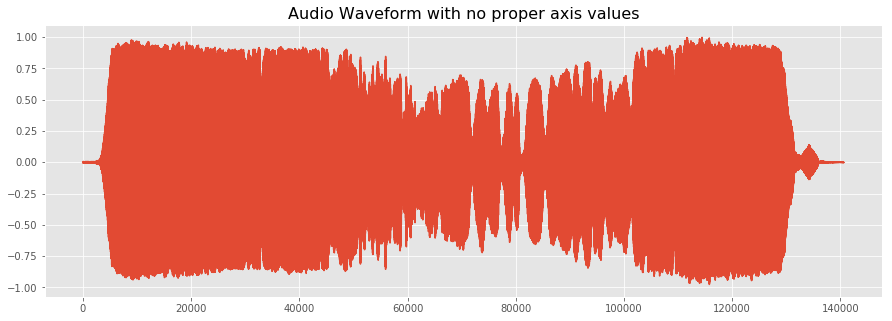

In [29]:
import matplotlib.pyplot as plt #Ploting library
from __future__ import print_function, division
%matplotlib inline
plt.style.use('ggplot') #plot style
plt.rcParams['figure.figsize'] = (15, 5) # set plot size
plt.plot(Audiodata)
plt.title('Audio Waveform with no proper axis values',size=16);

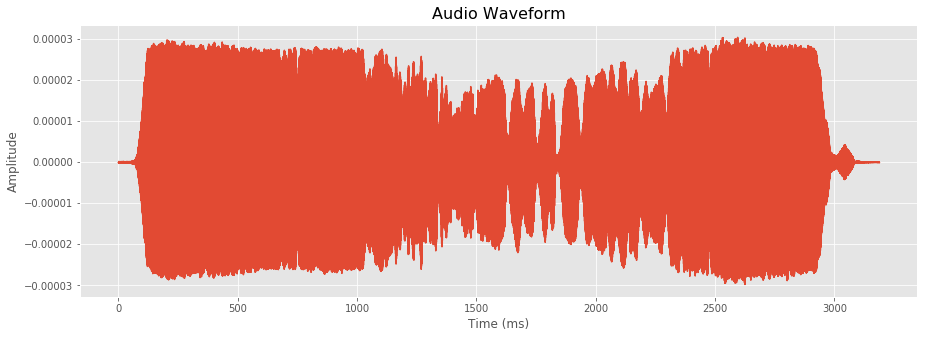

In [30]:
# Set proper values for plot axis
import numpy as np
# set data amplitude values between [-1 : 1] Audiodata.dtype is int16
AudiodataScaled = Audiodata / (2.**15)
#Set x axis values to milliseconds
timeValues = np.arange(0, len(AudiodataScaled), 1)/ fs # converting samples/Sec to Seconds
timeValues = timeValues * 1000  #scale to milliseconds
plt.plot(timeValues, AudiodataScaled);plt.title('Audio Waveform',size=16)
plt.ylabel('Amplitude'); plt.xlabel('Time (ms)');

# Writing Audio Files

In [4]:
# Making some modifications to audio file
LessGaindata = AudiodataScaled/2.0 # Dividing by two the amplitude to the signal
# Converting to int16 to save the audio file with 16 Bits @ 441000 Hz freq sampling
LessGaindata = LessGaindata*(2.**15)
LessGaindata = LessGaindata.astype(np.int16)
print(' Directory files before writing = ');
!ls ./Data # Jupyter Magic :)
# Writing de audio signal to a file
wavfile.write('Data/LessGain.wav',fs,LessGaindata)

 Directory files before writing = 
Beastie.wav   History_background.wav  Journey.wav     train05.wav
disco.wav     History_foreground.wav  LessGain.wav    Whistle.wav
flamenco.wav  History.wav	      percussive.wav
harmonic.wav  Journey_beats.wav       SMC_9.wav


In [5]:
## Note: You can write the audio file as float point in this way

# Making some modifications to audio file
LessGaindata = AudiodataScaled/2.0 # Dividing by two the amplitude to the signal
# Converting to int16 to save the audio file with 16 Bits @ 441000 Hz freq sampling
#LessGaindata = LessGaindata*(2.**15)  #Commenting to save in float point
#LessGaindata = LessGaindata.astype(np.int16)# Comenting to save in float point
print(' Directory files before writing = ');
!ls ./Data # Jupyter Magic :)
# Writing de audio signal to a file
wavfile.write('Data/LessGain.wav',fs,LessGaindata)

# The advantage is ->  the audio file data amplitude values will be between [-1 : 1]
# so, if read the audio file the values will be between [-1:1] directly.

 Directory files before writing = 
Beastie.wav   History_background.wav  Journey.wav     train05.wav
disco.wav     History_foreground.wav  LessGain.wav    Whistle.wav
flamenco.wav  History.wav	      percussive.wav
harmonic.wav  Journey_beats.wav       SMC_9.wav


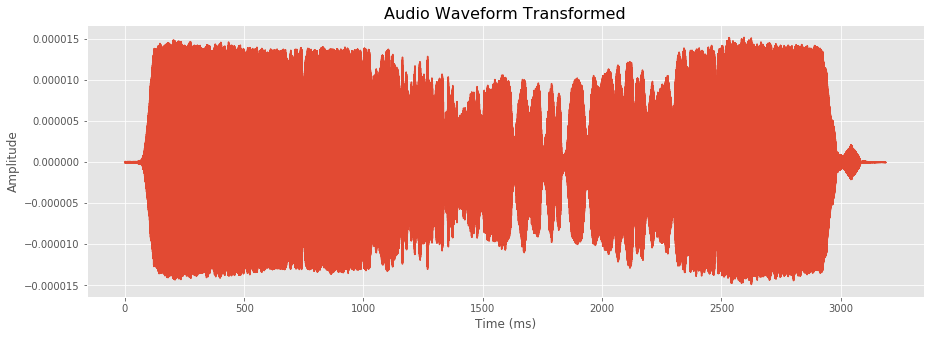

In [31]:
#Reading the new audiofile
fs, LessGain = wavfile.read('Data/LessGain.wav')
# set data amplitude values between [-1 : 1] LessGain.dtype is int16
LessGainScaled = LessGain / (2.**15)
plt.plot(timeValues,LessGainScaled);plt.title('Audio Waveform Transformed',size=16)
plt.ylabel('Amplitude'); plt.xlabel('Time (ms)');

# Frequency representation

* Fast Fourier Transform (FFT)
* Magnitude Spectrum plot(2D)
* Spectrogram (3D)

In [7]:
fs, Audiodata = wavfile.read(AudioFileName) # Reading AudioFile
Audiodata = Audiodata / (2.**15) # set data amplitude values between [-1 : 1]

from scipy.fftpack import fft
n = len(Audiodata) 
AudioFreq = fft(Audiodata) # Computing the fourier transform
AudioFreq = AudioFreq[0:int(np.ceil((n+1)/2.0))]
# FFT output is a array of complex numbers
MagFreq = np.abs(AudioFreq) # absolute value to obtain the magnitude

# scaling by the number of points to avoid that the magnitude values 
# depends of signal length the signal or its sampling frequency 
MagFreq = MagFreq / float(n)
# Compute the power of the magnitude
MagFreq = MagFreq**2  

## Magnitude Spectrum Plot (2D)

In [8]:
from plotly import offline as py #library for interactive plots
import plotly.tools as tls
py.init_notebook_mode()

In [32]:
# check if the nfft is odd to find the Nyquist point in the spectrum
if n % 2 > 0: # we've got odd number of points fft
    MagFreq[1:len(MagFreq)] = MagFreq[1:len(MagFreq)] * 2
else:# we've got even number of points fft
    MagFreq[1:len(MagFreq) -1] = MagFreq[1:len(MagFreq) - 1] * 2 

freqAxis = np.arange(0,int(np.ceil((n+1)/2.0)), 1.0) * (fs / n);
plt.plot(freqAxis/1000.0, 10*np.log10(MagFreq)) #Power spectrum
plt.xlabel('Frequency (kHz)'); plt.ylabel('Power (dB)');
py.iplot(tls.mpl_to_plotly(plt.gcf())) #use plotly for interactive plot

In [10]:
# Just for verification the rms value of the audio signal in time
# has to be the same as the value of the root square sum of the magnitude in frequency

rms_val = np.sqrt(np.mean(Audiodata**2))
SumMagnitude = np.sqrt(np.sum(MagFreq))
print('rms (time) = {} and the Sum of Magnitude peaks (Freq) = {}'.format(rms_val,SumMagnitude))
print(u'The values are the same \U0001f603');

rms (time) = 0.546087278384 and the Sum of Magnitude peaks (Freq) = 0.546087277388
The values are the same 😃


## Spectrogram

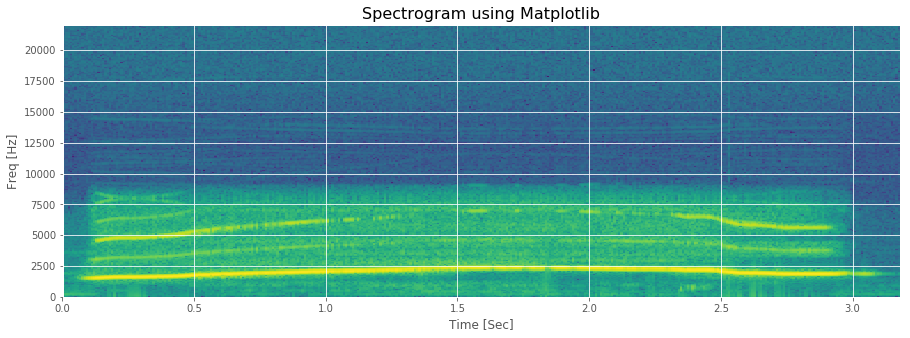

In [33]:
Fs, data = wavfile.read(AudioFileName)
data = data/(2.**15) # Scale the signal in [-1, 1] for 16 bits input
N = 512 #Number of points of fft
from scipy import signal
Pxx, freqs, bins, im = plt.specgram(data, NFFT=N, Fs=Fs,window = signal.blackman(N),noverlap = 128)
plt.title('Spectrogram using Matplotlib',size=16);
plt.ylabel('Freq [Hz]'); plt.xlabel('Time [Sec]');

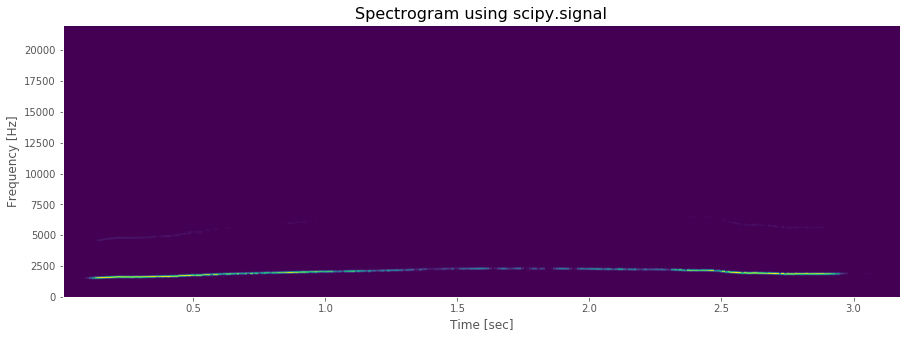

In [34]:
#spectrum computed using scipy
Fs, data = wavfile.read(AudioFileName)
data = data/(2.**15) # Scale the signal in [-1, 1] for 16 bits input
N = 512 #Number of points of fft
from scipy import signal
f, t, Sxx = signal.spectrogram(data, Fs,window = signal.blackman(N),nfft=N)
#plt.pcolormesh(t, f,10*np.log10(Sxx)) # dB Magnitude spectrum
plt.pcolormesh(t, f,Sxx) #Linear Magnitude spectrum
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.title('Spectrogram using scipy.signal',size=16);

# Application -> Music Information Retrieval
What Google does with text, MIR does it with music.
- Recommend, Organize and discover music in multimedia data bases
- Automatic musical information extraction in the Audio signals 
  - Beats and Tempo 
  - Melody
  - Harmony  
- New ways searching (Ex: Query by humming, Acoustic Fingerprint )

**Note: ** A **Music Information Retrieval** Course using python can be found at 
- https://github.com/stevetjoa/stanford-mir
- http://musicinformationretrieval.com/

# Applications

- Audio Beat tracking and Tempo Estimation
- Onset Detection
- Melody Detection
- Source Separation
   - Music / Voice separation
   - Harmonic / Percussive Separation

In [13]:
# Examples will be using Essentia Library,
# Import essentia library http://essentia.upf.edu/

import essentia
from essentia.standard import *
import warnings # some libraries display a future warning for deprecated functions used
warnings.filterwarnings('ignore')

** "Essentia: An Audio Analysis Library for Music Information Retrieval" ** ,Dmitry Bogdanov, Nicolas Wack, Emilia Gómez, Sankalp Gulati, Perfecto Herrera, Oscar Mayor, Gerard Roma, Justin Salamon, Jose R. Zapata, Xavier Serra. . 14th International Society for Music Information Retrieval Conference (ISMIR 2013), P. 493-498, Curitiba, Brazil, 2013. [Essentia](http://essentia.upf.edu)

## Audio Beat Tracking 
The task of Audio Beat Tracking refers to recovering a sequence of time instants from a musical input that are consistent with the times when a human might tap their foot.
## Tempo Estimation
Normally corresponds to the rate of the beats per minute, is associate with the interpretation speed of a piece of music. The computation of tempo is based on the periodicities extracted of the music signal and
the time differences between the beats.

![alt text](./Img/Rhythm.png "https://github.com/JoseRZapata/MultiFeatureBeatTracking")

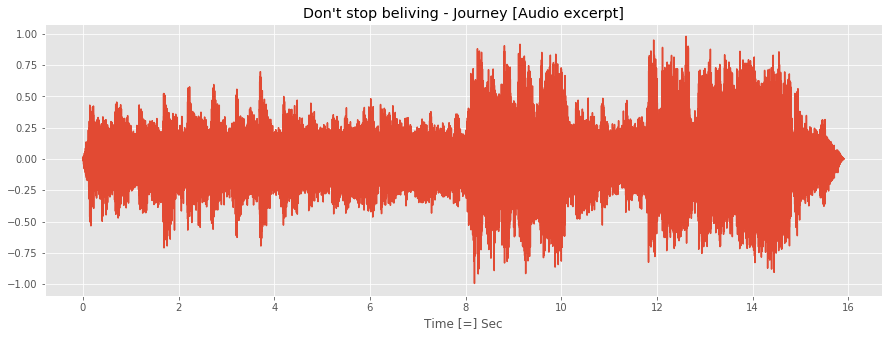

In [35]:
#Loading audio File with essentia
audiobeat = MonoLoader(filename='Data/Journey.wav')() #15 sec extract from -> Journey - Dont stop beliving 
#Plot audio waveform
plt.plot((np.arange(0, len(audiobeat), 1)/ 44100),audiobeat)#x axis in seconds
plt.title("Don't stop beliving - Journey [Audio excerpt]")
plt.xlabel("Time [=] Sec")
ipd.Audio('Data/Journey.wav')

In [15]:
# Compute beat positions and BPM
# with the multifeature Beat tracker implemented in essentia
rhythm_extractor = RhythmExtractor2013(method="multifeature")
bpm, beats, b_conf, _, _ = rhythm_extractor(audiobeat)

print("BPM:", bpm)
print("Beat positions (sec.):", beats)
print("Beat estimation confidence:", b_conf)

BPM: 118.452629089
Beat positions (sec.): [ 0.5456689  1.1261678  1.6718367  2.1594558  2.6702948  3.1695237
  3.6687527  4.1679816  4.6904306  5.1896596  5.6888885  6.199728
  6.710567   7.221406   7.732245   8.243084   8.777143   9.287982
  9.7988205 10.28644   10.797278  11.331338  11.830566  12.329796
 12.840634  13.351474  13.862312  14.361542  14.860771  15.39483  ]
Beat estimation confidence: 2.4355006218


** "Multi-Feature Beat Tracking" **, Jose R. Zapata, Matthew E.P. Davies, Emilia Gómez.  IEEE/ACM Transactions on Audio, Speech, and Language Processing, Vol. 22, No. 4, P. 816-825, 2014. [https://doi.org/10.1109/TASLP.2014.2305252](https://doi.org/10.1109/TASLP.2014.2305252)

In [16]:
# Mark beat positions on the audio and write it to a file
# Let's use beeps instead of white noise to mark them, as it's more distinctive
marker = AudioOnsetsMarker(onsets=beats, type='beep')
marked_audio = marker(audiobeat)
MonoWriter(filename='Data/Journey_beats.wav')(marked_audio)

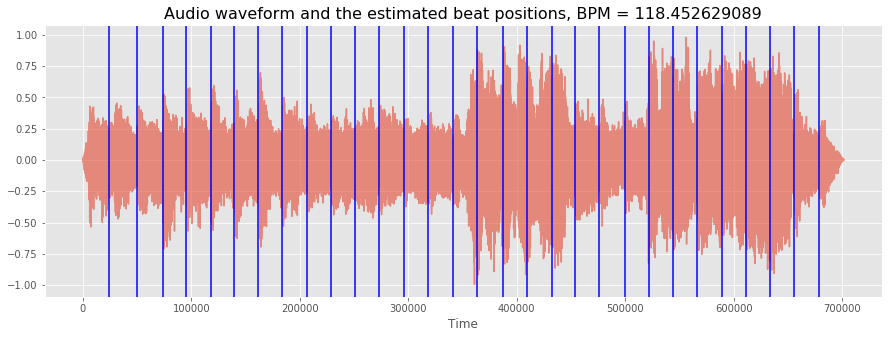

In [36]:
plt.plot(audiobeat,alpha=0.6) 
for beat in beats:
    # add beat times to the audio waveform plot
    plt.axvline(x=beat*44100, color='blue')
plt.title("Audio waveform and the estimated beat positions, BPM = {}".format(bpm),size=16);
plt.xlabel('Time');
ipd.Audio('Data/Journey_beats.wav')

## Note Onset Detection
The time position in the musical audio signal where a new note begins.

In [37]:
# Loading audio file
audioOnset = MonoLoader(filename='Data/Beastie.wav')()

# Phase 1: compute the onset detection function
# The OnsetDetection algorithm provides various onset detection functions. Let's use two of them.
od2 = OnsetDetection(method='complex')

In [19]:
# Let's also get the other algorithms we will need, and a pool to store the results
w = Windowing(type = 'hann')
fft = FFT() # this gives us a complex FFT
c2p = CartesianToPolar() # and this turns it into a pair (magnitude, phase)
pool = essentia.Pool()

# Computing onset detection functions.
for frame in FrameGenerator(audioOnset, frameSize = 1024, hopSize = 512):
    mag, phase, = c2p(fft(w(frame)))
    pool.add('features.complex', od2(mag, phase))

# Phase 2: compute the actual onsets locations
onsets = Onsets()
onsets_complex = onsets(essentia.array([ pool['features.complex'] ]),[ 1 ])

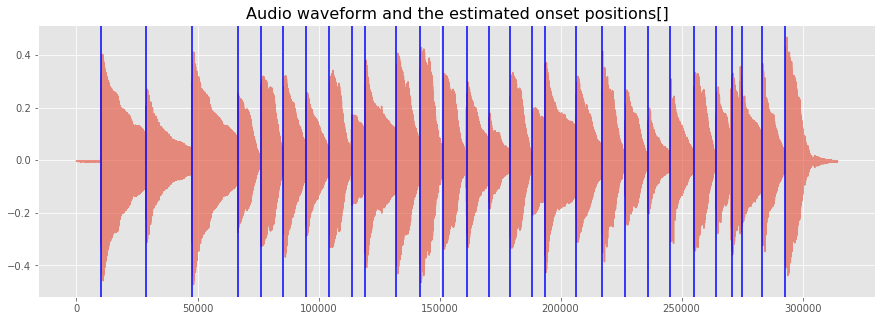

In [38]:
plt.plot(audioOnset,alpha=0.6)
for onset in onsets_complex:
    plt.axvline(x=onset*44100, color='blue')

plt.title("Audio waveform and the estimated onset positions[]",size=16);
ipd.Audio('Data/Beastie.wav')

## Melody Detection
Estimates the fundamental frequency of the predominant melody from polyphonic music signals.
![alt text](./Img/MKF3V.png "http://www.justinsalamon.com/melody-extraction.html")


In [21]:
# Load audio file; it is recommended to apply equal-loudness filter for PredominantPitchMelodia 
loader = EqloudLoader(filename='Data/SMC_9.wav', sampleRate=44100)
audio = loader()
print("Duration of the audio sample [sec]: {}".format(len(audio)/44100.0))
# Extract the pitch curve
# PitchMelodia takes the entire audio signal as input (no frame-wise processing is required)

pitch_extractor = PredominantPitchMelodia(frameSize=2048, hopSize=128)
pitch_values, pitch_confidence = pitch_extractor(audio)

# Pitch is estimated on frames. Compute frame time positions
pitch_times = np.linspace(0.0,len(audio)/44100.0,len(pitch_values) )

Duration of the audio sample [sec]: 40.0


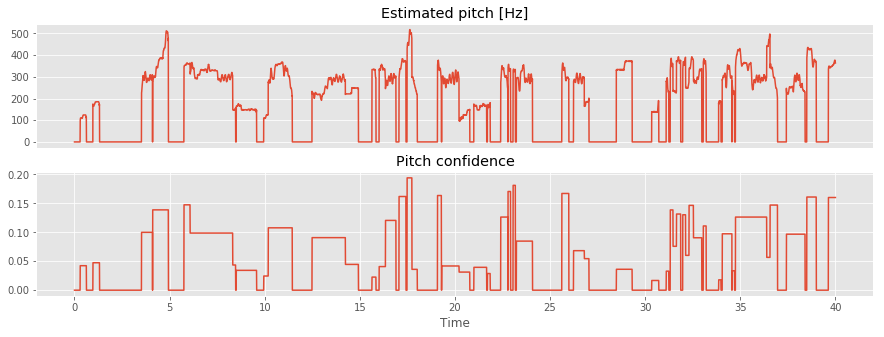

In [39]:
# Plot the estimated pitch contour and confidence over time
plt.subplot(211)
plt.plot(pitch_times, pitch_values)
plt.title('Estimated pitch [Hz]')
plt.xticks([]) #removing x axis numbers

plt.subplot(212)
plt.plot(pitch_times, pitch_confidence)
plt.title('Pitch confidence');plt.xlabel('Time');

** "Melody Extraction from Polyphonic Music Signals using Pitch Contour Characteristics" **, J. Salamon and E. Gómez, IEEE Transactions on Audio, Speech and Language Processing, 20(6):1759-1770, Aug. 2012.[https://doi.org/10.1109/TASL.2012.2188515](https://doi.org/10.1109/TASL.2012.2188515)

# Music / Voice Separation
The basic idea is to find the repeating elements in the audio mixture and extract the repeating background for music/voice separation
![alt text](./Img/repet.png "REPET http://zafarrafii.com/")


In [40]:
# Examples using The Northwestern University Source Separation Library (nussl) Library
import nussl #https://github.com/interactiveaudiolab/nussl

history = nussl.AudioSignal('./Data/History.wav')
repet = nussl.Repet(history)
repet.run();
beat_spectrum = repet.get_beat_spectrum()
repet.update_periods()
bkgd, fgnd = repet.make_audio_signals()

In [24]:
bkgd.write_audio_to_file('Data/History_background.wav');
fgnd.write_audio_to_file('Data/History_foreground.wav');
print('Original Audio')
ipd.display(ipd.Audio('Data/History.wav'))
print('Background Audio')
ipd.display(ipd.Audio('Data/History_background.wav'))
print('Foreground Audio')
ipd.display(ipd.Audio('Data/History_foreground.wav'))

Original Audio


Background Audio


Foreground Audio


# Harmonic / Percussive Separation 
The aim is to decompose the original music signal to the harmonic and the percussive parts of the signal.
![alt text](./Img/harmonic_percussive.png "http://mir.ilsp.gr/harmonic_percussive_separation.html")

In [25]:
# Examples will be using Librosa library -> https://librosa.github.io/
import librosa 
import librosa.display
y, sr = librosa.load('./Data/disco.wav')
D = librosa.stft(y);
D_harmonic, D_percussive = librosa.decompose.hpss(D,margin=3.0);
# Pre-compute a global reference power from the input spectrum
rp = np.max(np.abs(D));

In [26]:
fig = plt.figure(figsize=(15, 8))
plt.subplot(3, 1, 1)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=rp), y_axis='log')
plt.colorbar()
plt.title('Full spectrogram')

plt.subplot(3, 1, 2)
librosa.display.specshow(librosa.amplitude_to_db(D_harmonic, ref=rp), y_axis='log')
plt.colorbar()
plt.title('Harmonic spectrogram')

plt.subplot(3, 1, 3)
librosa.display.specshow(librosa.amplitude_to_db(D_percussive, ref=rp), y_axis='log', x_axis='time')
plt.colorbar()
plt.title('Percussive spectrogram')
plt.tight_layout();
plt.close(fig)# close figure to plot in the other cell to use

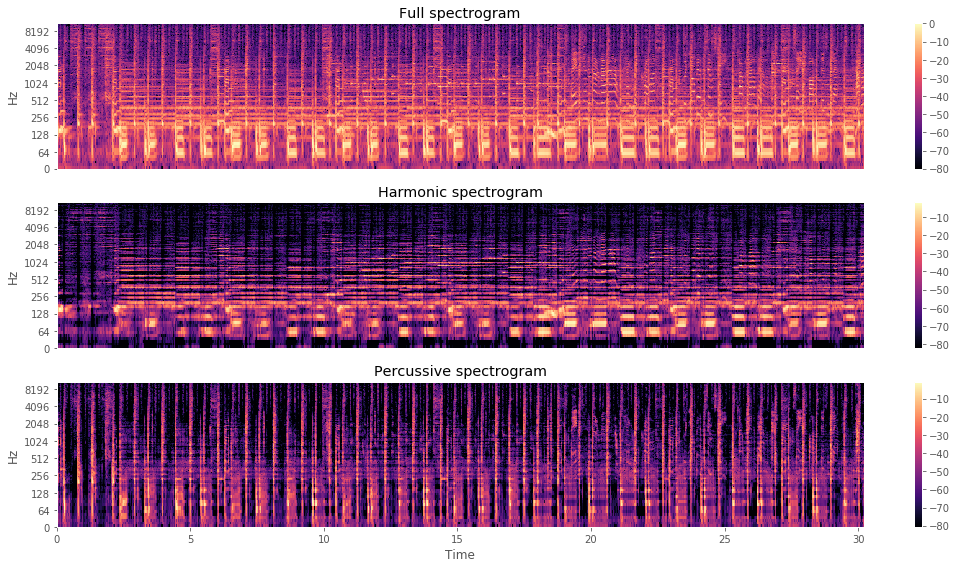

In [27]:
d = plt.figure()# plot figure from past cell
new_m = d.canvas.manager; new_m.canvas.figure = fig;fig.set_canvas(new_m.canvas)

In [28]:
y_harm = librosa.core.istft(D_harmonic) # Harmonic spectrum to audio signal in time
y_perc = librosa.core.istft(D_percussive) # Percussive spectrum to audio signal in time
librosa.output.write_wav('./Data/harmonic.wav',y_harm, sr)
librosa.output.write_wav('./Data/percussive.wav', y_perc, sr)
print('Original Audio'); ipd.display(ipd.Audio('Data/disco.wav'))
print('Harmonic Audio'); ipd.display(ipd.Audio('Data/harmonic.wav'))
print('Percussive Audio'); ipd.display(ipd.Audio('Data/percussive.wav'))

Original Audio


Harmonic Audio


Percussive Audio


# ¡THANKS!

|   |   |
|---|---|
    |<img style="float:left" src="Img/website.png" width="40px" height="40px"/>|<h1 class="text-primary">joserzapata.github.io</h1>|
|<img style="float:left" src="Img/github.png" width="50px" height="50px"/>|<h1 class='text-muted'>@joserzapata</h1>|
|<img style="float:left" src="Img/blue-twitter.png" width="50px" height="50px"/>|<h1 class="text-info">@joserzapata</h1>|
|<img style="float:left" src="Img/mail.png" width="40px" height="40px"/>|<h1 class="text-warning">joserzapata [@] upb.edu.co</h1>|
|   |   |